# Exploritory Data Analysis

In [154]:
import shapely
import pyproj
import fiona
import rasterio
import geopandas as geopd
import pandas as pd
from pandas import notnull

import os
import json
import geojson
import unicodedata

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### Import Develop Functions to Streamline Exploration and Handling of Raster Images

In [218]:
from ByronRS import ExploreRasterImage, CreateMaskArray, ExploreMultiBandImage, StoreBandinGPD

### Practice with Raster Data

In [15]:
input_file = os.path.join("../../../capstone_data/landsat_images/image_test.tif") #os.path.abspath('..'), 'data', 'landsat.tif')
#input_file = os.path.join("./no_canny_test.tif")

In [16]:
with rasterio.open(input_file) as src:
    meta_data = src.meta
    band = src.read(1)
    
    for i in [x for x in meta_data]:
        print i.upper() + ': ', meta_data[i]

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


In [17]:
image_height_to_width_ratio = float(meta_data['height']) / float(meta_data['width'])
image_height_to_width_ratio

0.6130696474634566

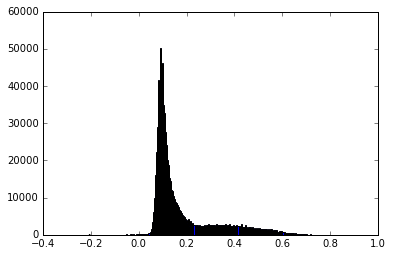

In [18]:
plt.hist(np.ravel(band), bins=260)
plt.show()

In [19]:
15.0*image_height_to_width_ratio

9.19604471195185

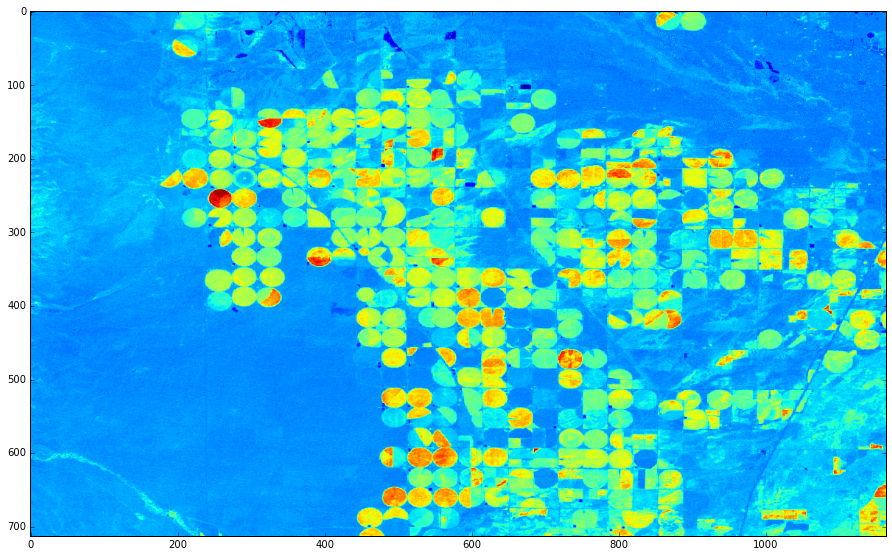

In [20]:
plt.figure(figsize=(25.0*image_height_to_width_ratio,25.0))
plt.imshow(band) #, cmap='gray')
plt.show()

NDVI composite

1. Size
2. Shade / Intense
3. Cons/Pattern (feature calculation which you then use to classify; discrete wavelet transform)

In [21]:
#from skimage.feature import corner_harris, corner_subpix, corner_peaks
#from skimage.transform import warp, AffineTransform

In [22]:
#tform = AffineTransform(scale=(1.3, 1.1), rotation=1, shear=0.7,
#                        translation=(210, 50))
#image = band

#coords = corner_peaks(corner_harris(image), min_distance=5)
#coords_subpix = corner_subpix(image, coords, window_size=13)

# Supervised Image Analysis
tutorial: http://www.machinalis.com/blog/python-for-geospatial-data-processing/

In [23]:
import numpy as np
import os

from osgeo import gdal
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier

# A list of "random" colors (for a nicer output)
COLORS = ["#000000", "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941"]

In [24]:
def create_mask_from_vector(vector_data_path, cols, rows, geo_transform,
                            projection, target_value=1):
    """Rasterize the given vector (wrapper for gdal.RasterizeLayer)."""
    data_source = gdal.OpenEx(vector_data_path, gdal.OF_VECTOR)
    layer = data_source.GetLayer(0)
    driver = gdal.GetDriverByName('MEM')  # In memory dataset
    target_ds = driver.Create('', cols, rows, 1, gdal.GDT_UInt16)
    target_ds.SetGeoTransform(geo_transform)
    target_ds.SetProjection(projection)
    gdal.RasterizeLayer(target_ds, [1], layer, burn_values=[target_value])
    return target_ds


def vectors_to_raster(file_paths, rows, cols, geo_transform, projection):
    """Rasterize the vectors in the given directory in a single image."""
    labeled_pixels = np.zeros((rows, cols))
    for i, path in enumerate(file_paths):
        label = i+1
        ds = create_mask_from_vector(path, cols, rows, geo_transform,
                                     projection, target_value=label)
        band = ds.GetRasterBand(1)
        labeled_pixels += band.ReadAsArray()
        ds = None
    return labeled_pixels


def write_geotiff(fname, data, geo_transform, projection):
    """Create a GeoTIFF file with the given data."""
    driver = gdal.GetDriverByName('GTiff')
    rows, cols = data.shape
    dataset = driver.Create(fname, cols, rows, 1, gdal.GDT_Byte)
    dataset.SetGeoTransform(geo_transform)
    dataset.SetProjection(projection)
    band = dataset.GetRasterBand(1)
    band.WriteArray(data)
    dataset = None  # Close the file

In [25]:
raster_data_path = "../../../capstone_data/data/image/2298119ene2016recorteTT.tif"
output_fname = "../../../capstone_data/classification.tiff"
train_data_path = "../../../capstone_data/data/test/"
validation_data_path = "../../../capstone_data/data/train/"


#train_data_path = "data/train/"
#validation_data_path = "data/test/"

In [26]:
with rasterio.open(raster_data_path) as src:
    meta_data = src.meta
    band = src.read(1)
    
    for i in [x for x in meta_data]:
        print i.upper() + ': ', meta_data[i]

COUNT:  7
CRS:  CRS({'init': u'epsg:32720'})
DTYPE:  float32
AFFINE:  | 30.00, 0.00, 416415.00|
| 0.00,-30.00, 6663145.00|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (416415.0, 30.0, 0.0, 6663145.0, 0.0, -30.0)
HEIGHT:  2500
WIDTH:  1000
NODATA:  None


In [27]:
image_height_to_width_ratio = float(meta_data['height']) / float(meta_data['width'])
image_height_to_width_ratio

2.5

In [28]:
raster_dataset = gdal.Open(raster_data_path, gdal.GA_ReadOnly)
geo_transform = raster_dataset.GetGeoTransform()
proj = raster_dataset.GetProjectionRef()
bands_data = []
for b in range(1, raster_dataset.RasterCount+1):
    band = raster_dataset.GetRasterBand(b)
    bands_data.append(band.ReadAsArray())

bands_data = np.dstack(bands_data)
rows, cols, n_bands = bands_data.shape

In [29]:
files = [f for f in os.listdir(train_data_path) if f.endswith('.shp')]
classes = [f.split('.')[0] for f in files]

#See image below for sample from shapefiles
shapefiles = [os.path.join(train_data_path, f)
              for f in files if f.endswith('.shp')]

labeled_pixels = vectors_to_raster(shapefiles, rows, cols, geo_transform,
                                   proj)

is_train = np.nonzero(labeled_pixels)
training_labels = labeled_pixels[is_train]
training_samples = bands_data[is_train]

In [30]:
print training_samples.shape
print training_labels.shape

(2398, 7)
(2398,)


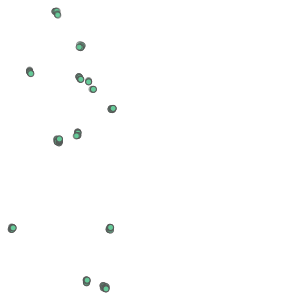

In [31]:
from shapely.geometry import shape

c = fiona.open(shapefiles[3])
pol = c.next()
geom = shape(pol['geometry'])
geom

In [32]:
classifier = RandomForestClassifier(n_jobs=-1)
classifier.fit(training_samples, training_labels)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=-1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [33]:
n_samples = rows*cols
flat_pixels = bands_data.reshape((n_samples, n_bands))
result = classifier.predict(flat_pixels)
classification = result.reshape((rows, cols))

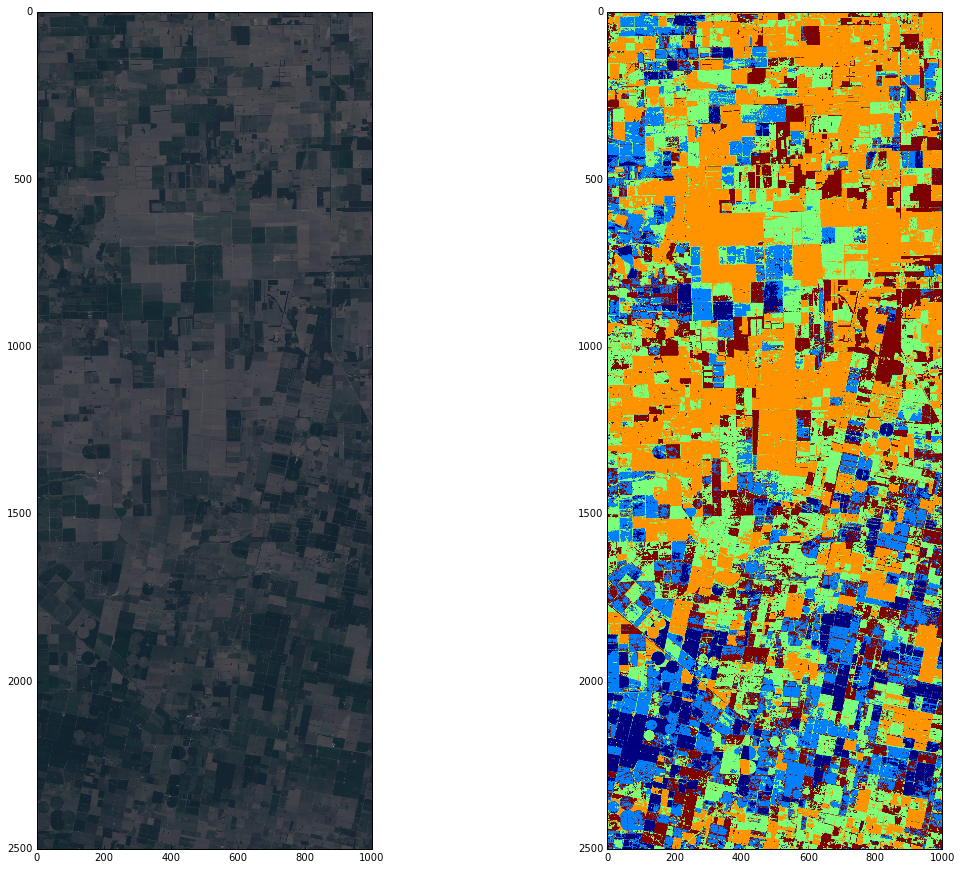

In [34]:
from matplotlib import pyplot as plt
f = plt.figure(figsize=(15.0*image_height_to_width_ratio, 15.0))
f.add_subplot(1, 2, 2)
r = bands_data[:,:,3]
g = bands_data[:,:,2]
b = bands_data[:,:,1]
rgb = np.dstack([r,g,b])
f.add_subplot(1, 1, 1)
plt.imshow(rgb/255)
f.add_subplot(1, 2, 2)
plt.imshow(classification)

In [35]:
write_geotiff(output_fname, classification, geo_transform, proj)

In [36]:
shapefiles = [os.path.join(validation_data_path, "%s.shp" % c)
              for c in classes]
verification_pixels = vectors_to_raster(shapefiles, rows, cols,
                                        geo_transform, proj)
for_verification = np.nonzero(verification_pixels)
verification_labels = verification_pixels[for_verification]
predicted_labels = classification[for_verification]

In [37]:
print("Confussion matrix:\n%s" %
      metrics.confusion_matrix(verification_labels, predicted_labels))

Confussion matrix:
[[171  11   0   0   1]
 [  7 127   1   0   6]
 [  0   0 177  19   0]
 [  0   0  13 427   1]
 [  0   0   4   0 374]]


In [38]:
target_names = ['Class %s' % s for s in classes]
print("Classification report:\n%s" %
      metrics.classification_report(verification_labels, predicted_labels,
                                    target_names=target_names))
print("Classification accuracy: %f" %
      metrics.accuracy_score(verification_labels, predicted_labels))

Classification report:
             precision    recall  f1-score   support

    Class A       0.96      0.93      0.95       183
    Class B       0.92      0.90      0.91       141
    Class C       0.91      0.90      0.91       196
    Class D       0.96      0.97      0.96       441
    Class E       0.98      0.99      0.98       378

avg / total       0.95      0.95      0.95      1339

Classification accuracy: 0.952950


### Image Exploration | Starting 30 October 2015
Attempting to download annual composite Landsat 8 images and see how they compare to images from individual months. Will areas with EVI be greater or will their be issues?

### EVI and NDVI Composite Images

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


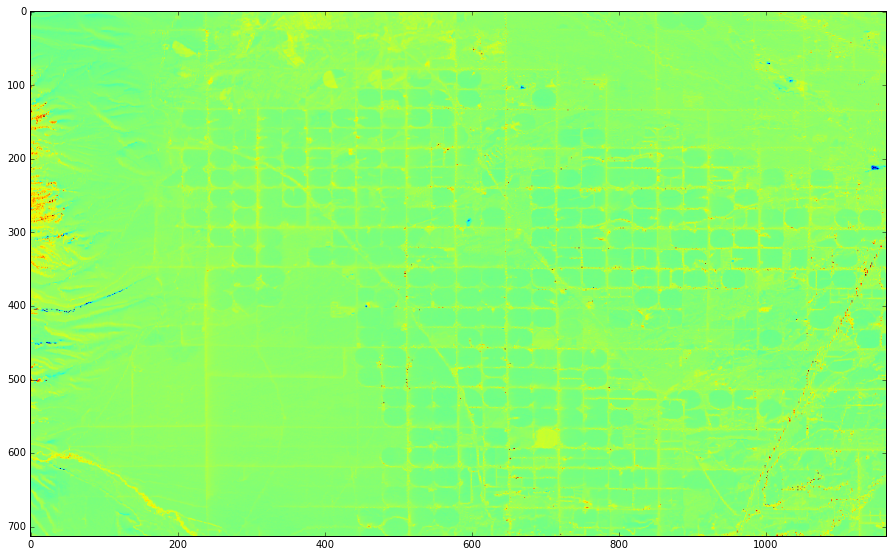

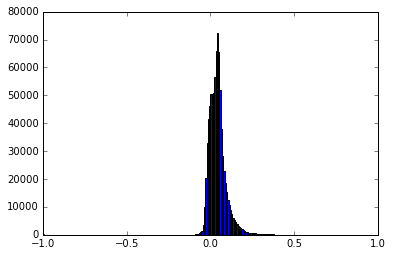

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


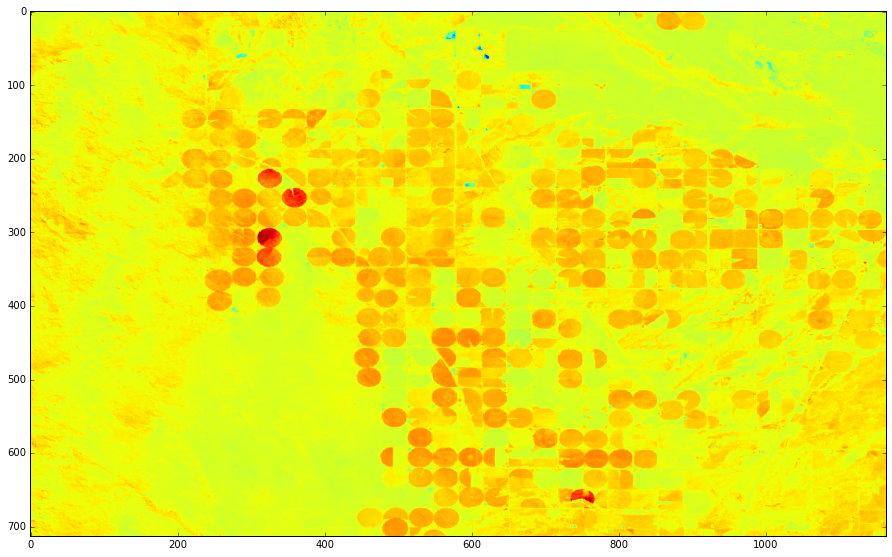

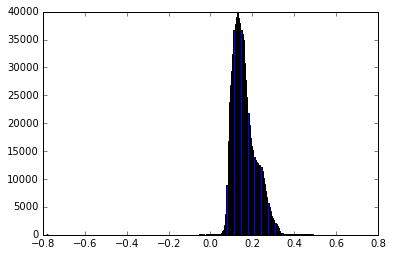

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


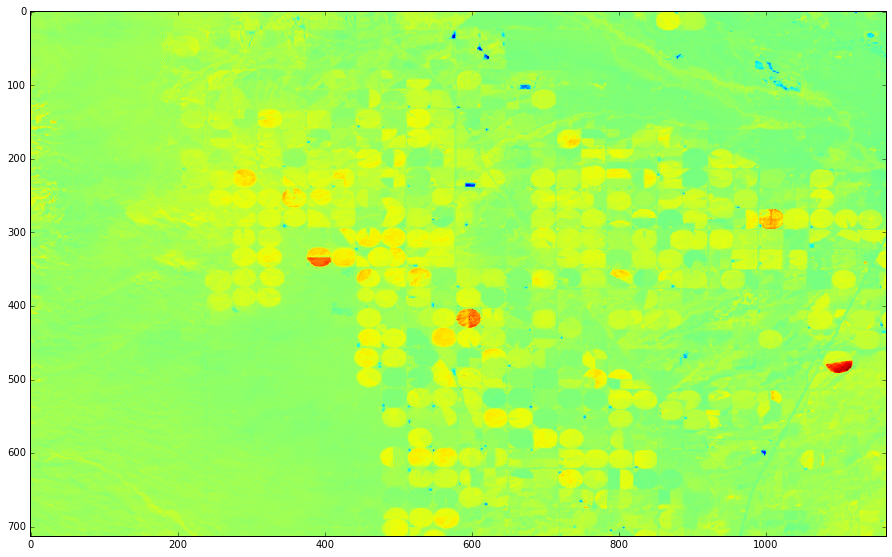

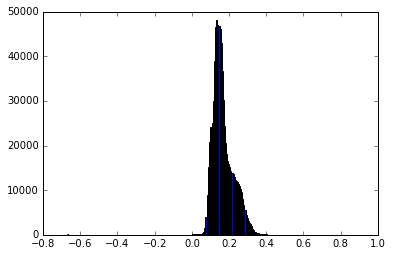

In [187]:
for number in [str(3),str(4),str(5)]:
    input_file = os.path.join("../../../capstone_data/landsat_images/LANDSAT_EVI_201%s.tif" % number)
    ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float32
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


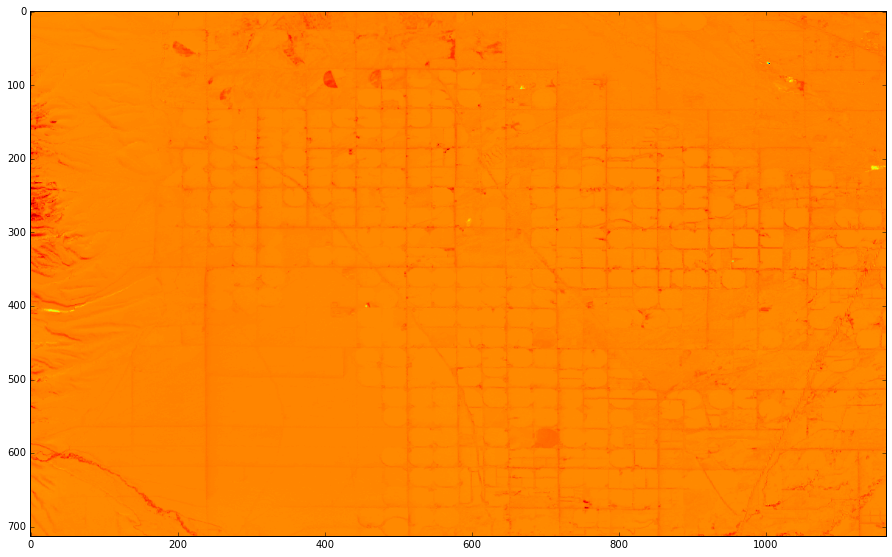

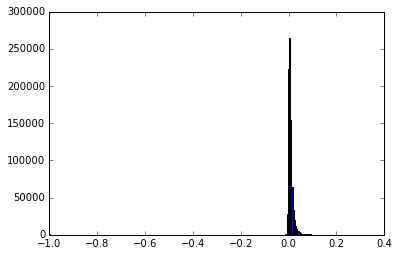

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float32
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


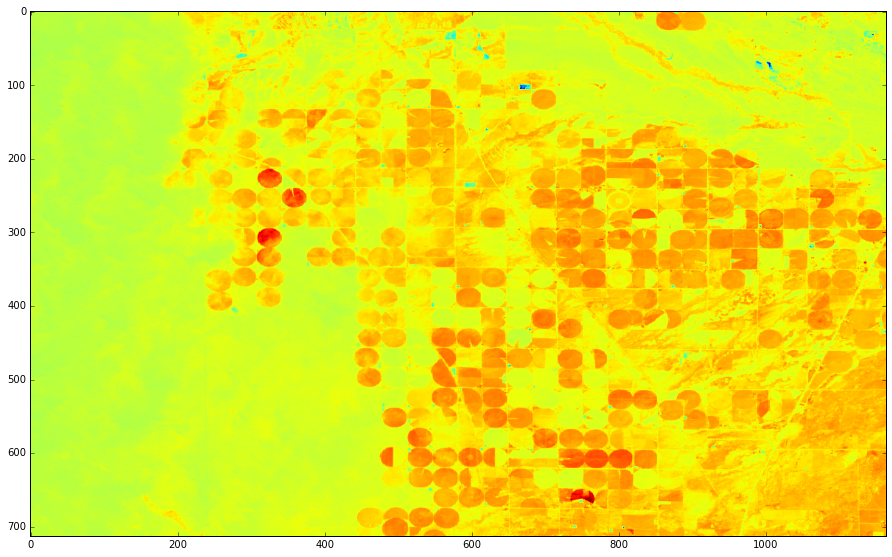

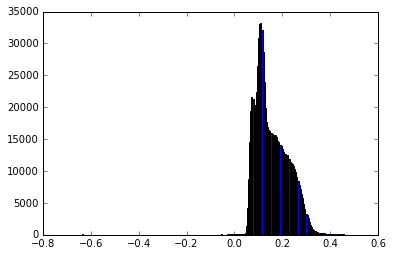

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float32
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


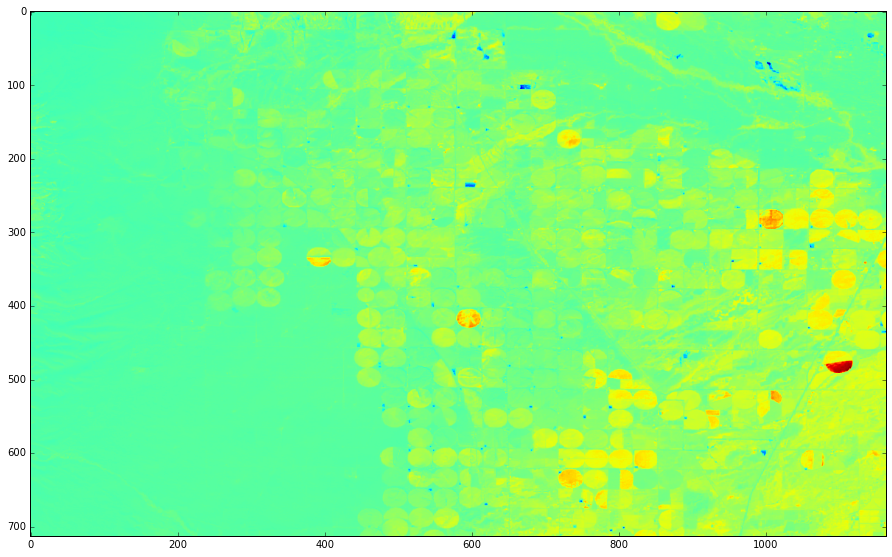

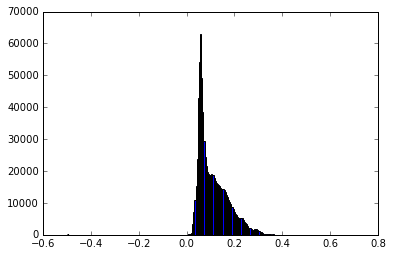

In [41]:
for number in [str(3),str(4),str(5)]:
    input_file = os.path.join("../../../capstone_data/landsat_images/LANDSAT_NDVI_201%s.tif" % number)
    ExploreRasterImage(input_file)

### EVI Image Exploration (Samples Throughout 2011)
Composite images are not usable, so I'm looking at individual EVI images.

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


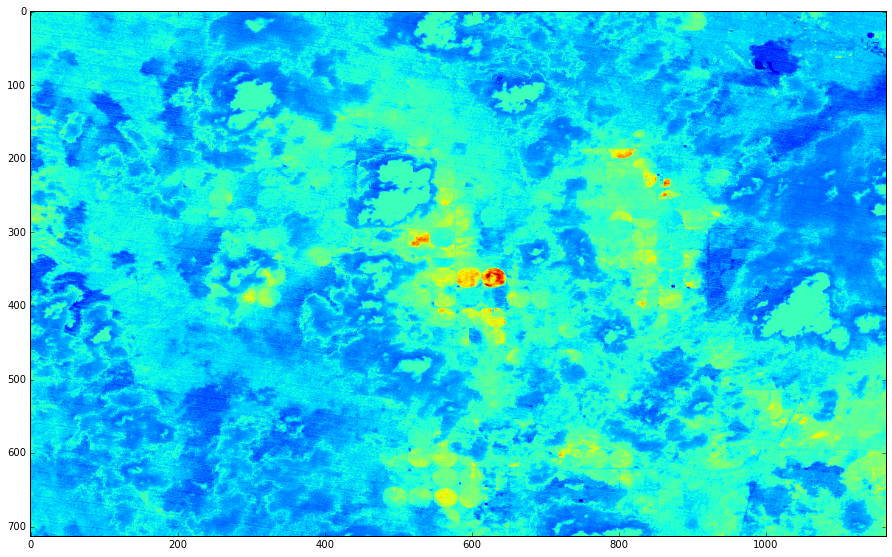

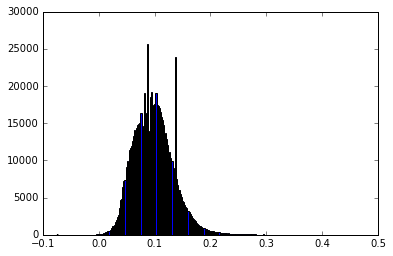

In [42]:
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110407.tif")
ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


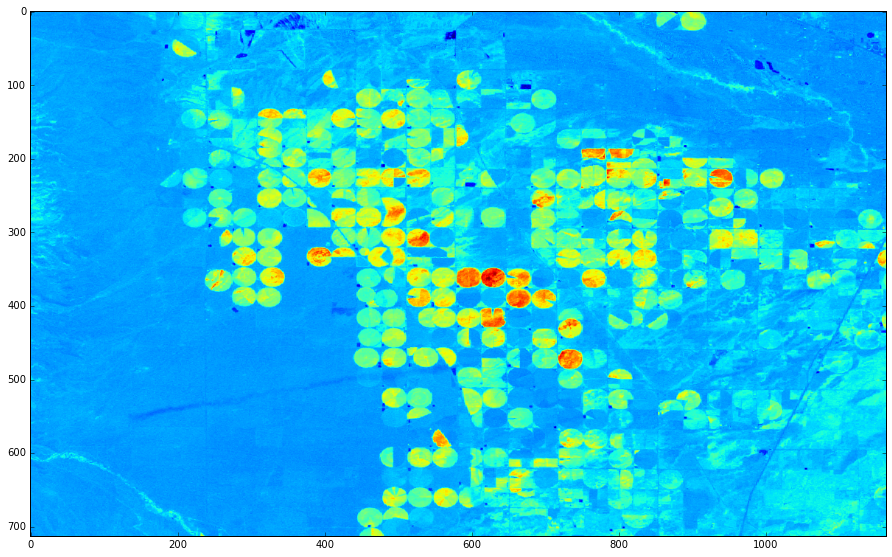

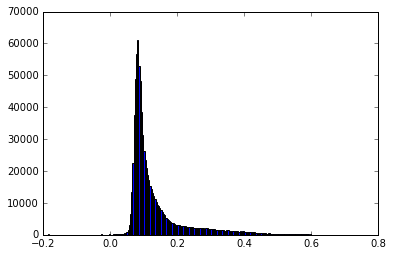

In [43]:
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110501.tif")
ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


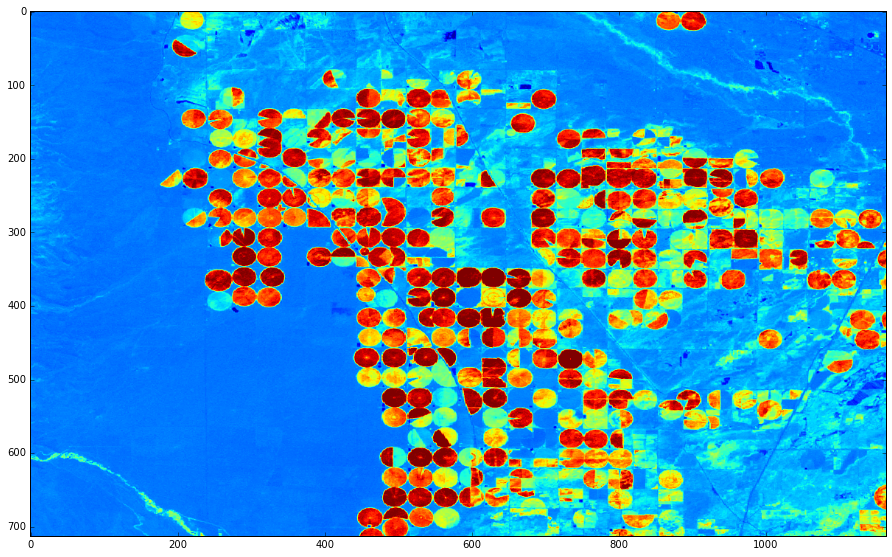

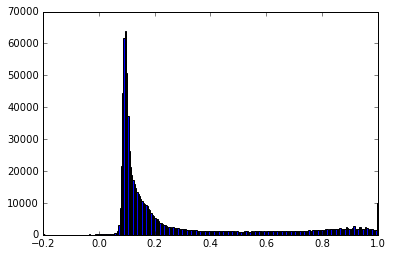

In [44]:
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110602.tif")
ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


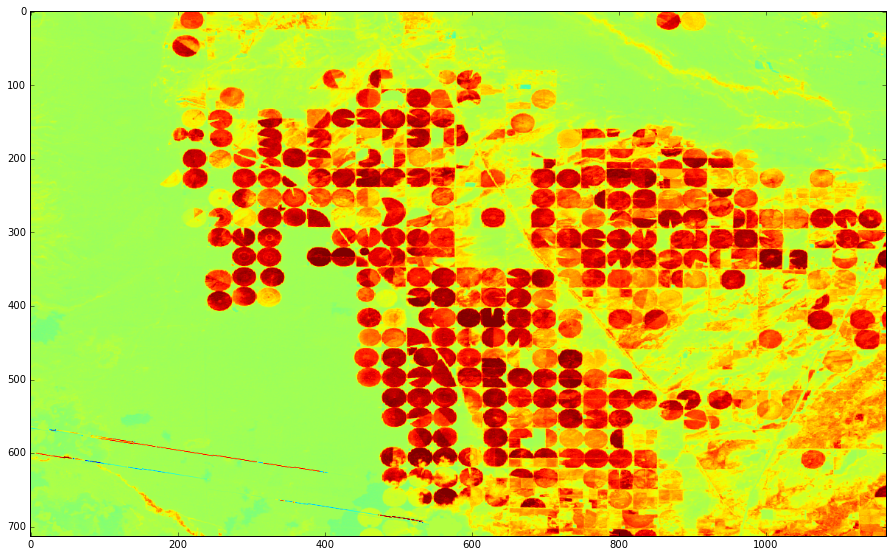

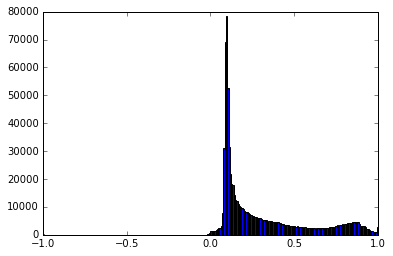

In [45]:
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110704.tif")
ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


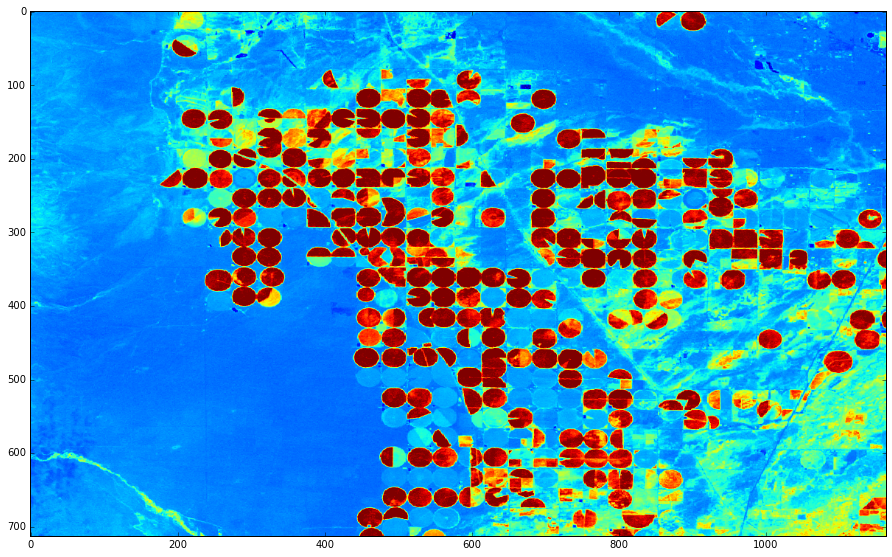

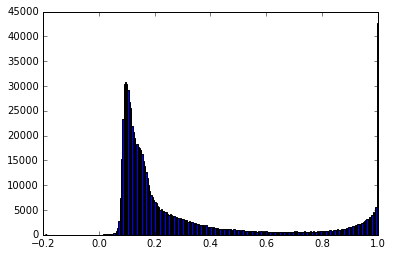

In [46]:
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_EIGHT_DAY_EVI_AUGUST_2011.tif")
ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


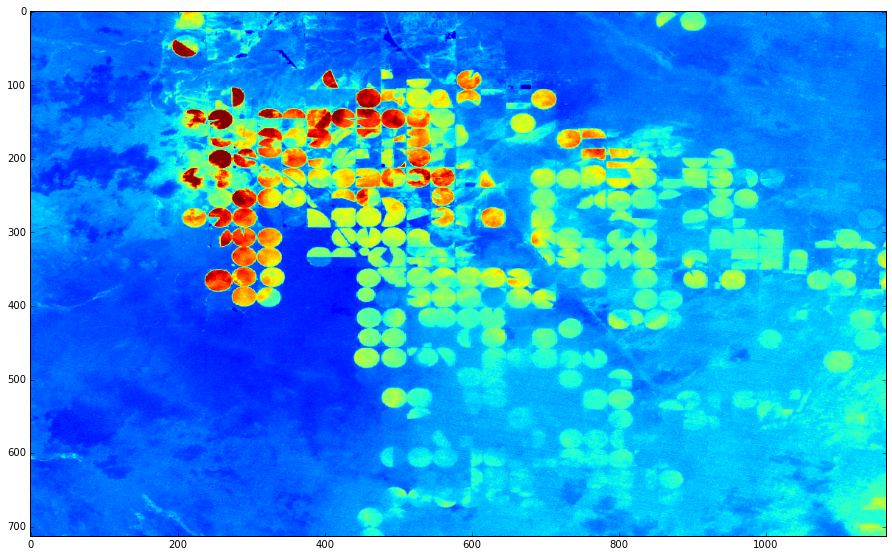

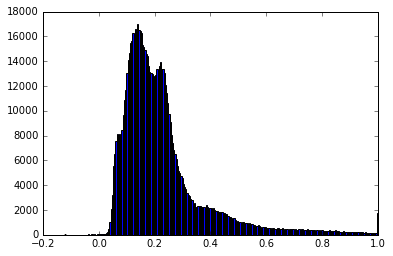

In [47]:
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110906.tif")
ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


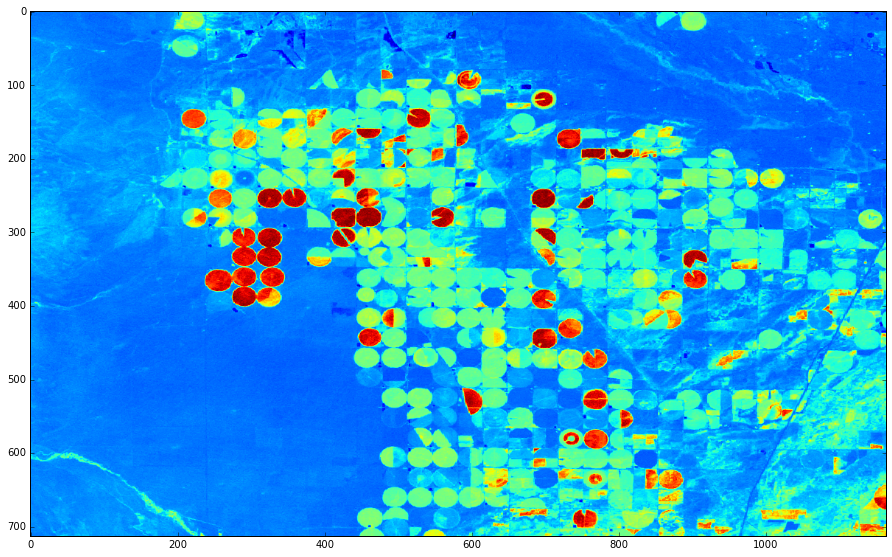

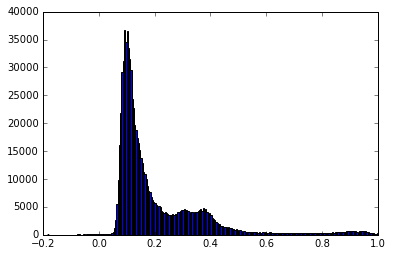

In [48]:
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110922.tif")
ExploreRasterImage(input_file)

### Explore Creation of Shapefiles and Masks from Remote Sensing Data

In [49]:
import shapely
from shapely.geometry import Point, LineString, Polygon, MultiPoint, GeometryCollection
from shapely.geometry.geo import asShape, mapping
from rasterio.tools.mask import mask

input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110602.tif")
with rasterio.open(input_file) as src:
    meta_data = src.meta
    band = src.read(1)

    for i in [x for x in meta_data]:
        print i.upper() + ': ', meta_data[i]
    print '###############################'
    print 
        
    #Transform into mask_array
    mask_array = np.where(band > 0.45, 1.0, 0.0)
    ii = np.nonzero(mask_array == 1)
    mask_coords = tuple(zip(*ii))
    

    #mask_polygons = Polygon(shell=mask_coords)
    #mask_LineString = LineString(mask_coords)
    #mask_multipoint = MultiPoint(mask_coords)
    #mask_multipoint_shape = mask_multipoint.buffer(0.05)
    #geoms = mask_multipoint_shape.geoms
    
    out_image, out_transform = mask(src, geoms)
    out_meta = src.meta.copy()
    out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "transform": out_transform})
    src.close
    
with rasterio.open("../../../capstone_data/masked.tif", "w", **out_meta) as dest:
    dest.write(out_image)
    dest.close
    
input_file = os.path.join('../../../capstone_data/masked.tif')
ExploreRasterImage(input_file)

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None
###############################



NameError: name 'geoms' is not defined

In [ ]:
import rasterio
from scipy.signal import medfilt

path = "tests/data/RGB.byte.tif"
output = "/tmp/filtered.tif"

with rasterio.open(path) as src:
    array = src.read()
    profile = src.profile

# apply a 5x5 median filter to each band
filtered = medfilt(array, (1, 5, 5)).astype('uint8')

# Write to tif, using the same profile as the source
with rasterio.open(output, 'w', **profile) as dst:
    dst.write(filtered)

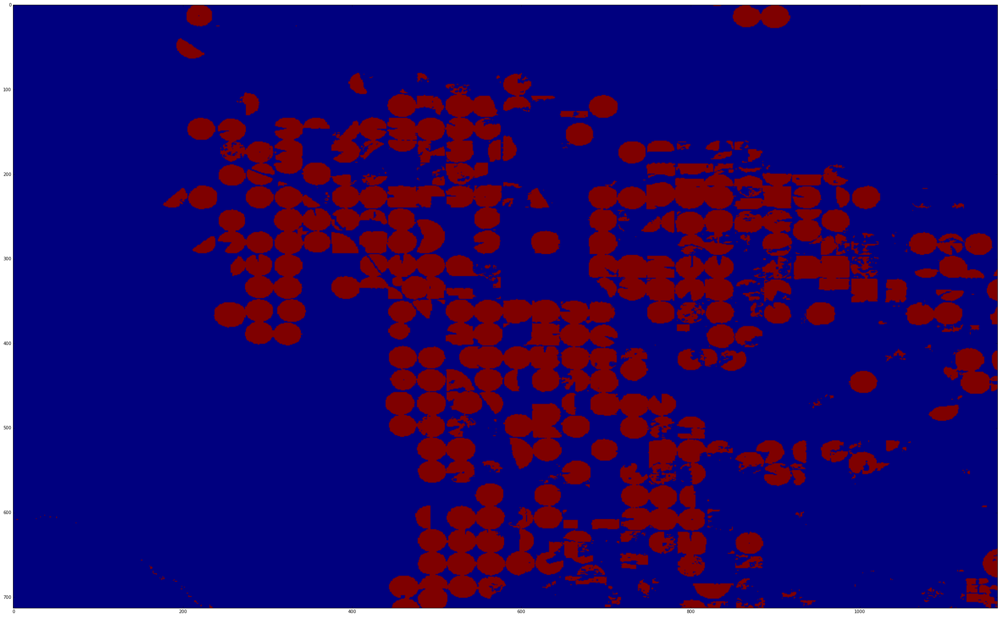

In [50]:
#Fill in holes in mask_array
from scipy import ndimage

#open_img = ndimage.binary_opening(mask_array)
#mask_array = ndimage.binary_closing(open_img)

plt.figure(figsize=(25.0*image_height_to_width_ratio, 25.0))
plt.imshow(mask_array) 
plt.show()

In [52]:
#Transform Array to Raster

import gdal, ogr, os, osr
import numpy as np

# this allows GDAL to throw Python Exceptions
gdal.UseExceptions()

def array2raster(newRasterfn,rasterOrigin,pixelWidth,pixelHeight,array):

    cols = array.shape[1]
    rows = array.shape[0]
    originX = rasterOrigin[0]
    originY = rasterOrigin[1]

    driver = gdal.GetDriverByName('GTiff')
    outRaster = driver.Create(newRasterfn, cols, rows, 1, gdal.GDT_Byte)
    outRaster.SetGeoTransform((originX, pixelWidth, 0, originY, 0, pixelHeight))
    outband = outRaster.GetRasterBand(1)
    outband.WriteArray(array)
    outRasterSRS = osr.SpatialReference()
    outRasterSRS.ImportFromEPSG(4326)
    outRaster.SetProjection(outRasterSRS.ExportToWkt())
    outband.FlushCache()


def main(newRasterfn,rasterOrigin,pixelWidth,pixelHeight,array):
    #reversed_arr = array[::-1] # reverse array so the tif looks like the array #this appears to be unnecessary
    array2raster(newRasterfn,rasterOrigin,pixelWidth,pixelHeight,array) # convert array to raster


if __name__ == "__main__":
    rasterOrigin = (-106.0352, 37.4307)
    pixelWidth = 713
    pixelHeight = 1163
    newRasterfn = '../../../capstone_data/array2raster_test.tif'
    array = image_threshold

    main(newRasterfn,rasterOrigin,pixelWidth,pixelHeight,array)

NameError: name 'image_threshold' is not defined

COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint8
AFFINE:  | 713.00, 0.00,-106.04|
| 0.00, 1163.00, 37.43|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.0352, 713.0, 0.0, 37.4307, 0.0, 1163.0)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


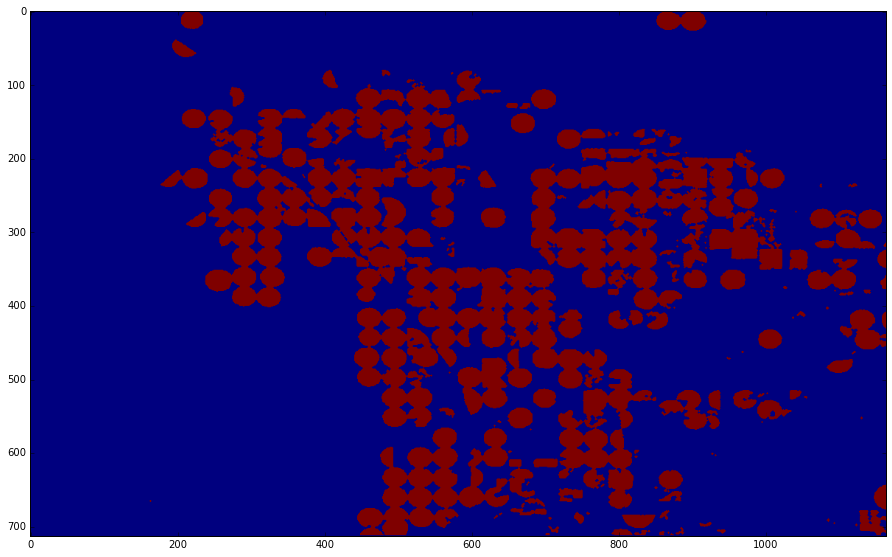

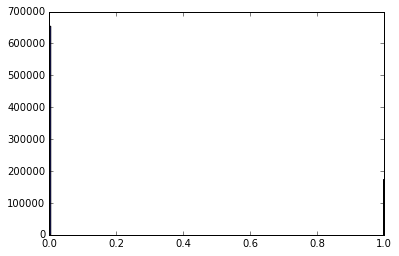

In [53]:
input_file = os.path.join("../../../capstone_data/array2raster_test.tif")
ExploreRasterImage(input_file)

In [55]:
#create shapefile from raster image
import sys

#open source
src_ds = gdal.Open( "../../../capstone_data/array2raster_test.tif" )
#src_ds.SetGCPs('EPSG:4326', 4326)

if src_ds is None:
    print 'Unable to open %s' % src_filename
    sys.exit(1)

try:
    srcband = src_ds.GetRasterBand(1)
    maskband = srcband.GetMaskBand()
except RuntimeError, e:
    print e
    sys.exit(1)

path = '../../../capstone_data/'
dst_layername = "raster2polygon_test9"
drv = ogr.GetDriverByName("ESRI Shapefile")
dst_ds = drv.CreateDataSource( path + dst_layername + ".shp" ) #path + 

dst_layer = dst_ds.CreateLayer(dst_layername, srs = None )

gdal.Polygonize(srcband, maskband, dst_layer, -1, [], callback=None ) 

0

http://gis.stackexchange.com/questions/27426/creating-a-mask-with-transparent-pixels-in-python

In [56]:
#Open our original data as read only
dataset = gdal.Open("../../../capstone_data/array2raster_test.tif", gdal.GA_ReadOnly)

#Note that unlike the rest of Python, Raster Bands in GDAL are numbered beginning with 1.
#I suspect this is to conform to the landsat band naming convention
band = dataset.GetRasterBand(1)

#Read in the data from the band to a numpy array
data = band.ReadAsArray()
data = data.astype(np.float)

#Use numpy, scipy, and whatever Python to make some output data
#That for ease of use should be an array of the same size and dimensions
#as the input data.

#Note -9999 is a convenience value for null - there's no number for
#transparent values - it's just how you visualise the data in the viewer

out_data = np.where(abs(data) > 0., 2., -9999.)


#And now we start preparing our output
driver = gdal.GetDriverByName("GTiff")
metadata = driver.GetMetadata()

#Create an output raster the same size as the input
out = driver.Create("../../../capstone_data/out_file.tif",
                    dataset.RasterXSize,
                    dataset.RasterYSize,
                    1, #Number of bands to create in the output
                    gdal.GDT_Float32)

#Copy across projection and transform details for the output
out.SetProjection(dataset.GetProjectionRef())
out.SetGeoTransform(dataset.GetGeoTransform()) 

#Get the band to write to
out_band = out.GetRasterBand(1)

#And write our processed data
out_band.WriteArray(out_data)

0

Polygon
OrderedDict([(u'FID', 0)])


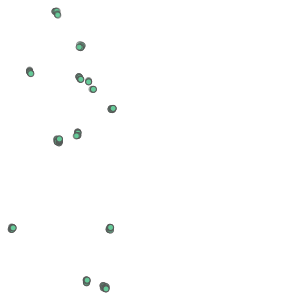

In [57]:
input_file = os.path.join('../../../capstone_data/raster2polygon_test8.shp') 

src = fiona.open(input_file)
f = src.next()
print(f['geometry']['type'])
print(f['properties'])
geoms = shape(f['geometry'])
geom

### Try Image Segmentation and OBIA

In [58]:
from skimage import exposure
from skimage.segmentation import quickshift, felzenszwalb
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
from matplotlib import colors

10998


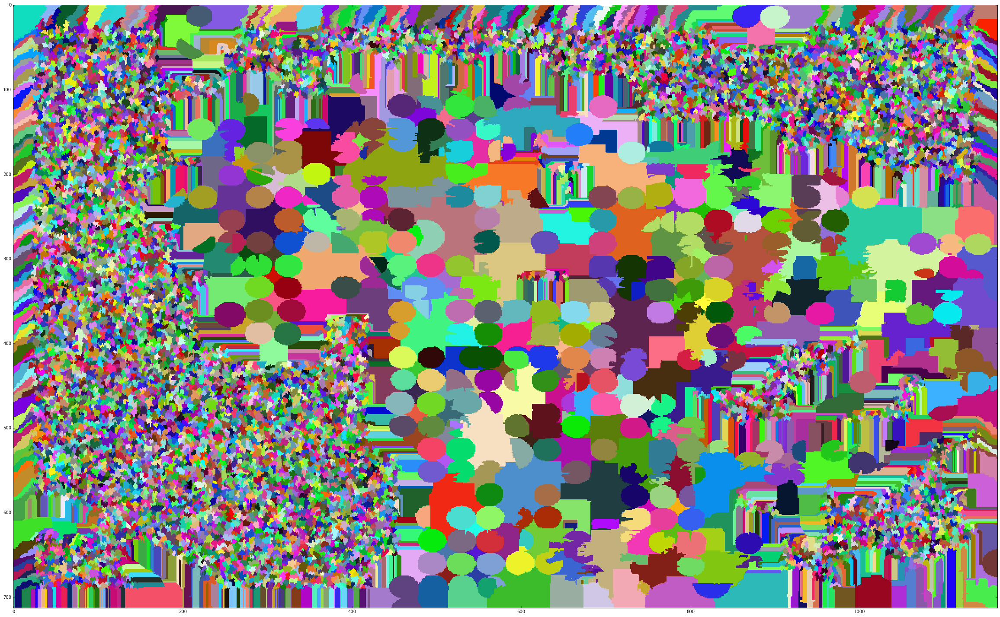

In [61]:
img = exposure.rescale_intensity(mask_array)

segments_quick = quickshift(img, kernel_size=7, max_dist=3, ratio=0.35, convert2lab=False)
n_segments = len(np.unique(segments_quick))
print(n_segments)

cmap = colors.ListedColormap(np.random.rand(n_segments, 3))
plt.figure(figsize=(25.0*image_height_to_width_ratio,25.0))
plt.imshow(segments_quick, interpolation='none', cmap=cmap)

### Explore new functions and multi-band data

In [216]:
from geopandas import GeoSeries, GeoDataFrame, read_file

In [198]:
# Test CreateMaskArray()
input_file = os.path.join("../../../capstone_data/landsat_images/LT5_L1T_8DAY_EVI_20110602.tif")
threshold_float = 0.45
mask_array = CreateMaskArray(input_file, threshold_float)
mask_array

-------------------------------------
Generating mask array from input file...

META DATA
COUNT:  1
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  float64
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None

Returning mask array... 


array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  1.,  1.,  0.],
       [ 0.,  0.,  0., ...,  1.,  1.,  1.],
       [ 0.,  0.,  0., ...,  0.,  0.,  1.]])

BAND NUMBER 1
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


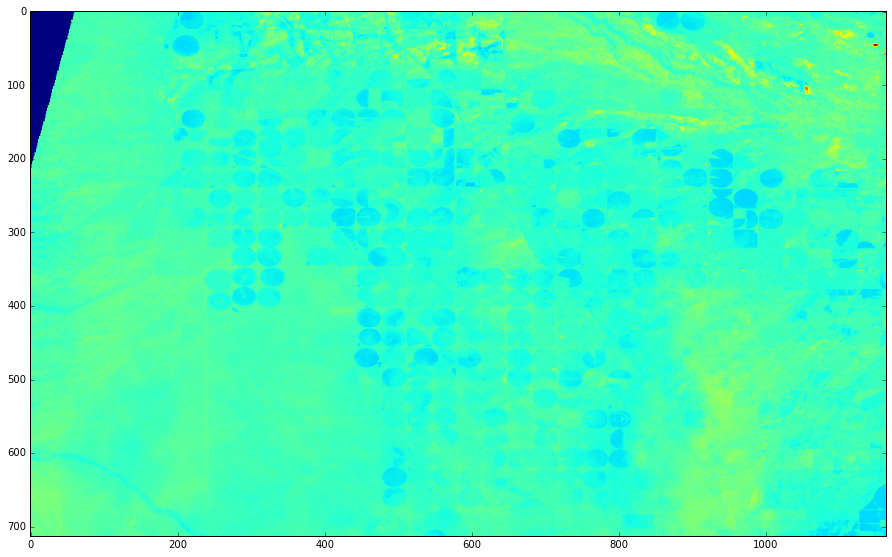

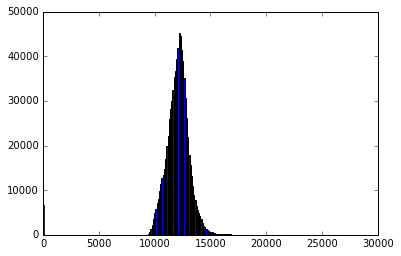

BAND NUMBER 2
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


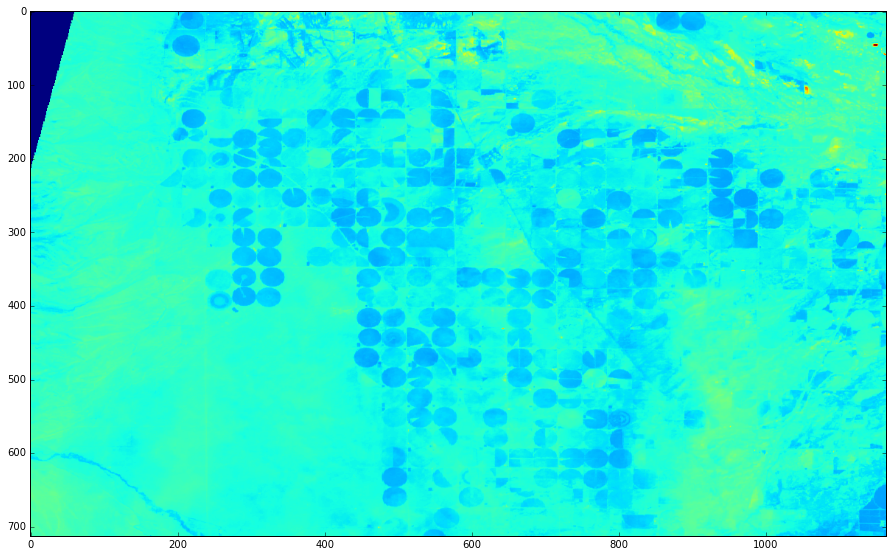

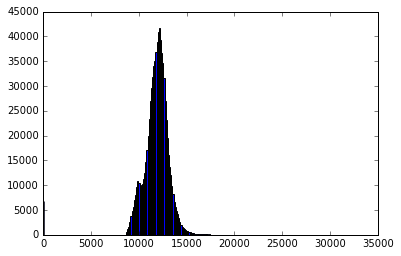

BAND NUMBER 3
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


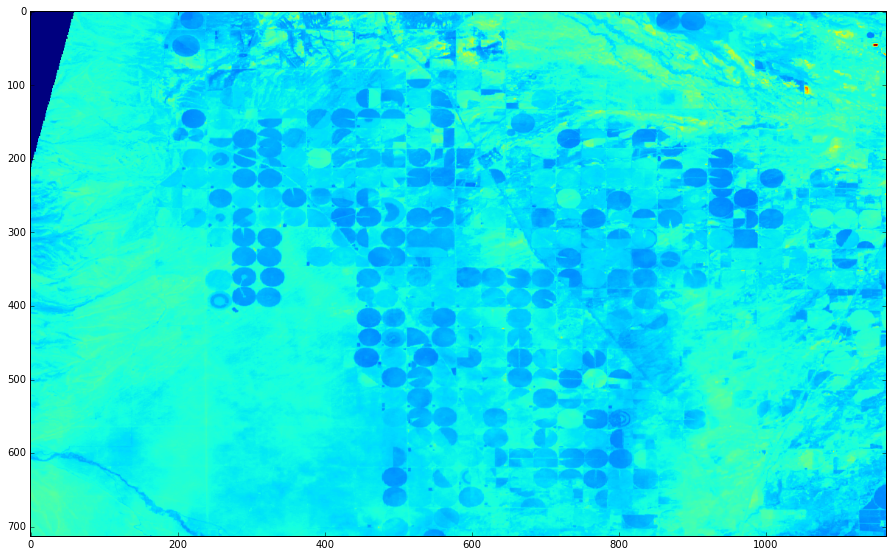

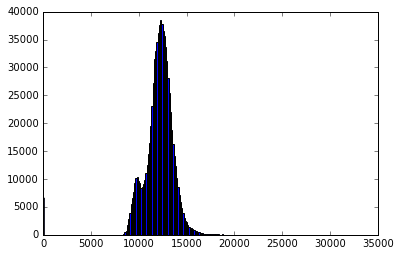

BAND NUMBER 4
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


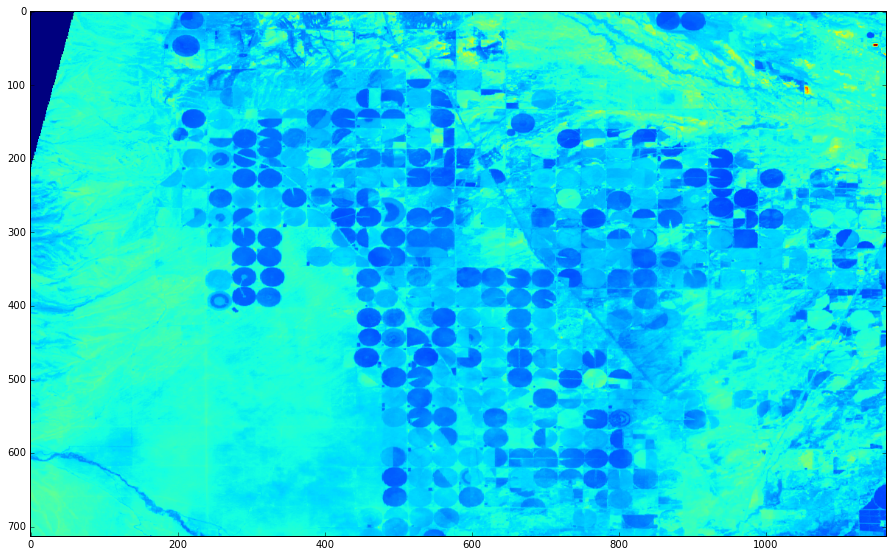

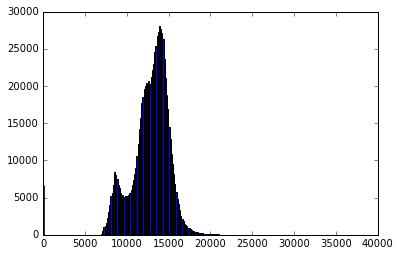

BAND NUMBER 5
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


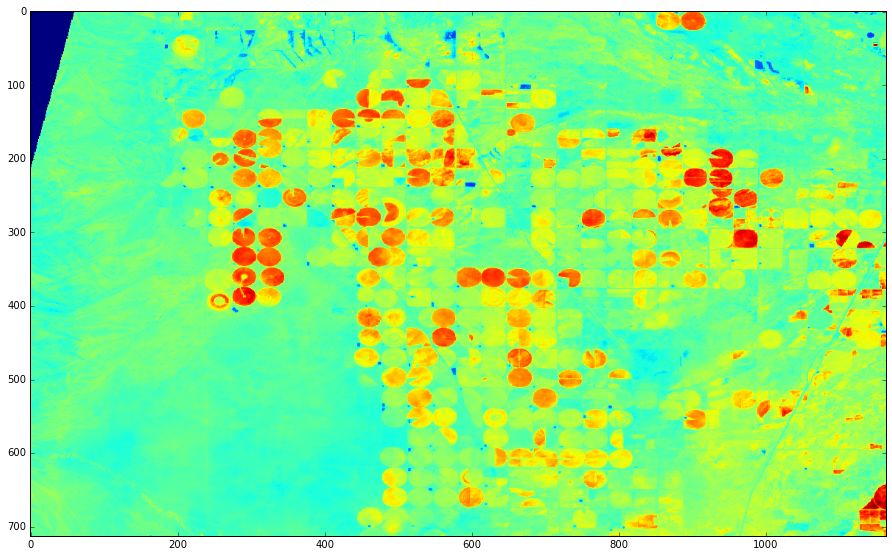

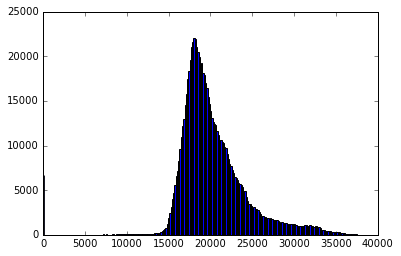

BAND NUMBER 6
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


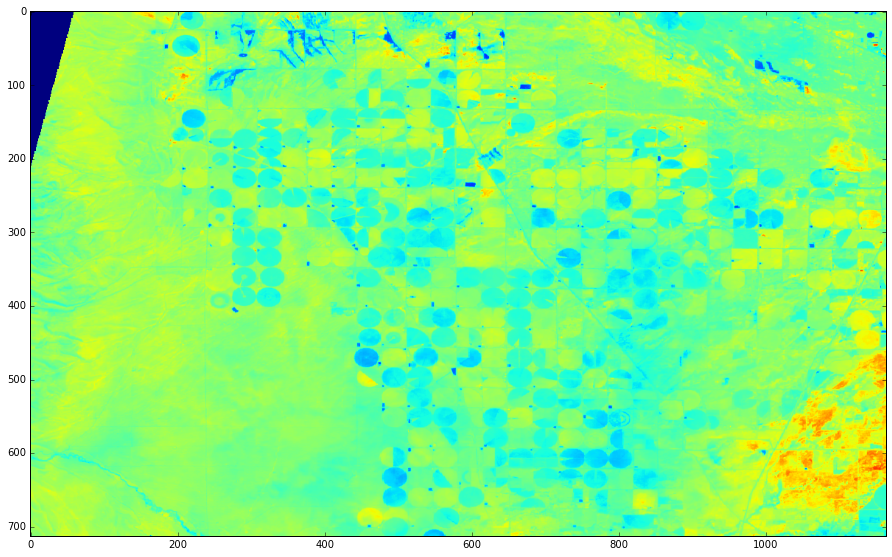

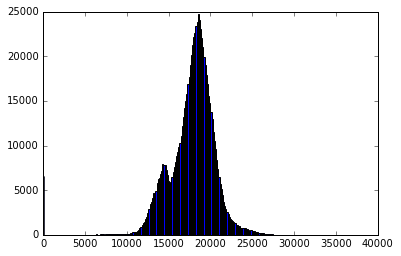

BAND NUMBER 7
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


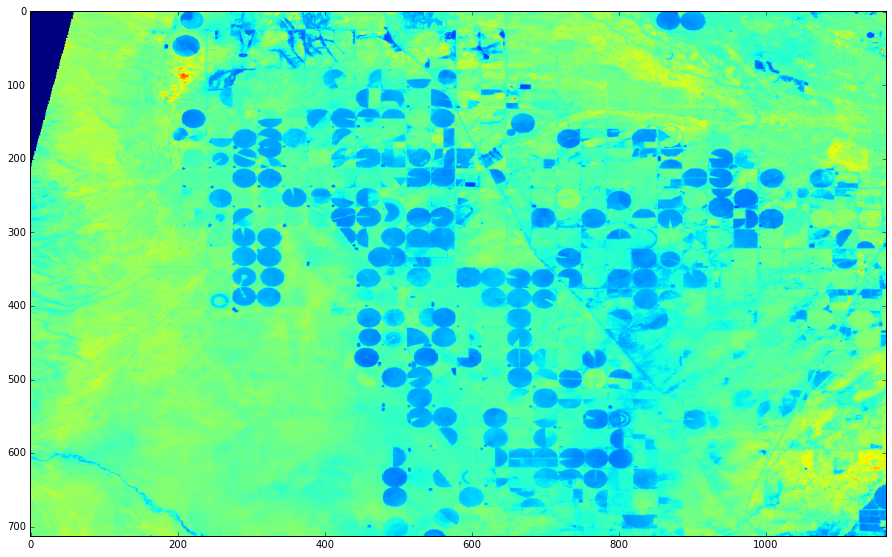

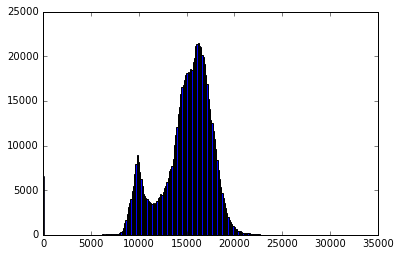

BAND NUMBER 8
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


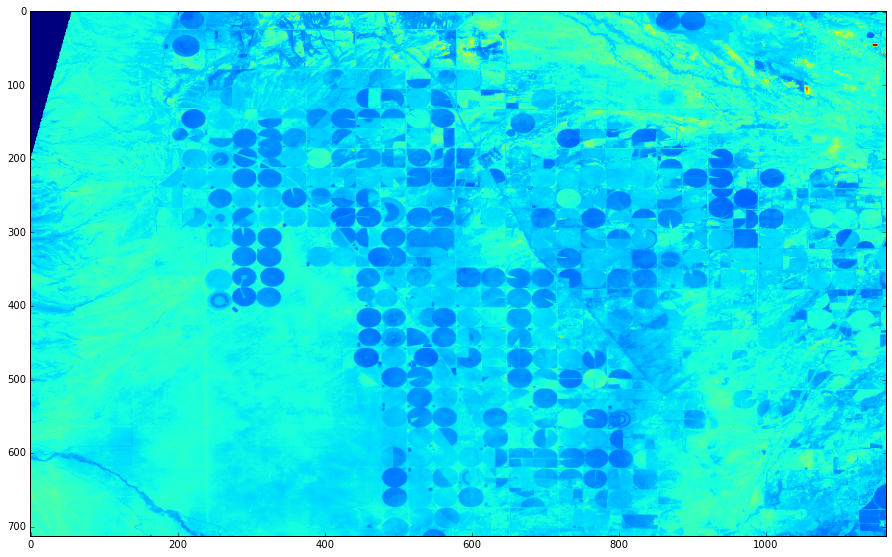

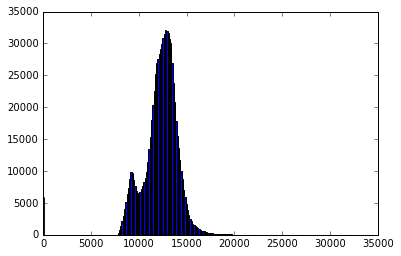

BAND NUMBER 9
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


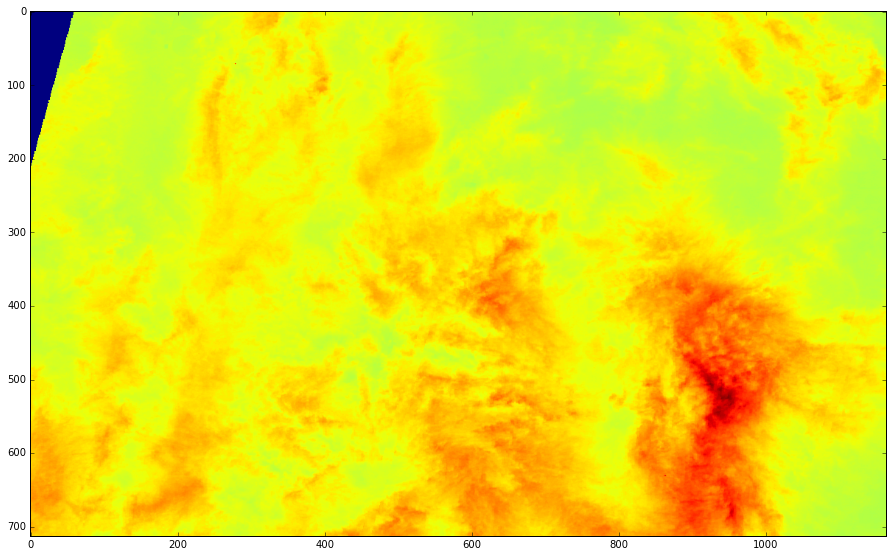

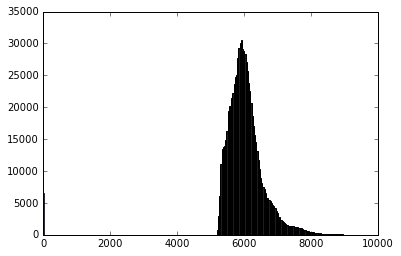

BAND NUMBER 10
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


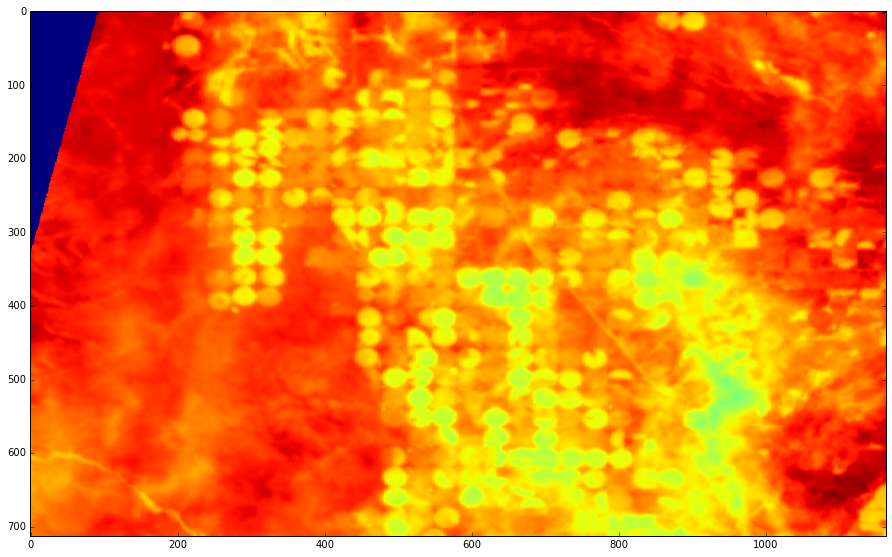

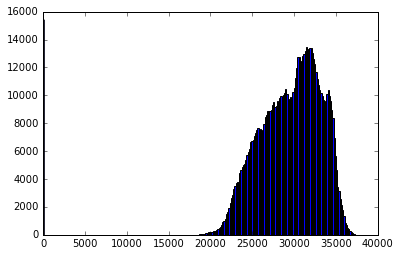

BAND NUMBER 11
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


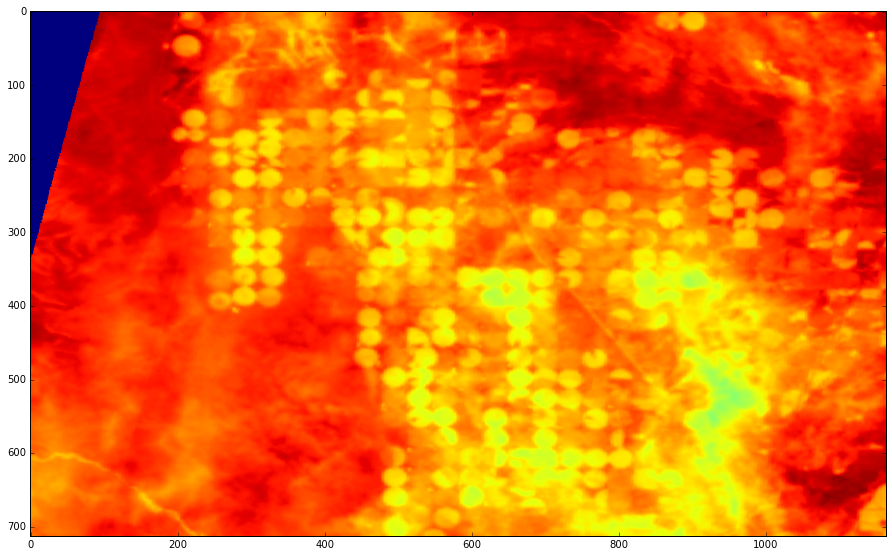

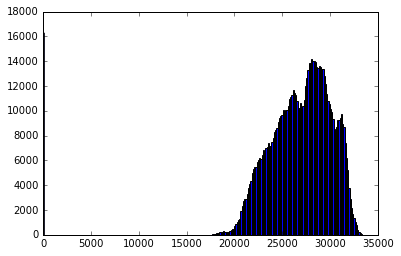

BAND NUMBER 12
COUNT:  12
CRS:  CRS({'init': u'epsg:4326'})
DTYPE:  uint16
AFFINE:  | 0.00, 0.00,-106.21|
| 0.00,-0.00, 37.50|
| 0.00, 0.00, 1.00|
DRIVER:  GTiff
TRANSFORM:  (-106.21320593315575, 0.00026949458523585647, 0.0, 37.495051138449945, 0.0, -0.00026949458523585647)
HEIGHT:  713
WIDTH:  1163
NODATA:  None


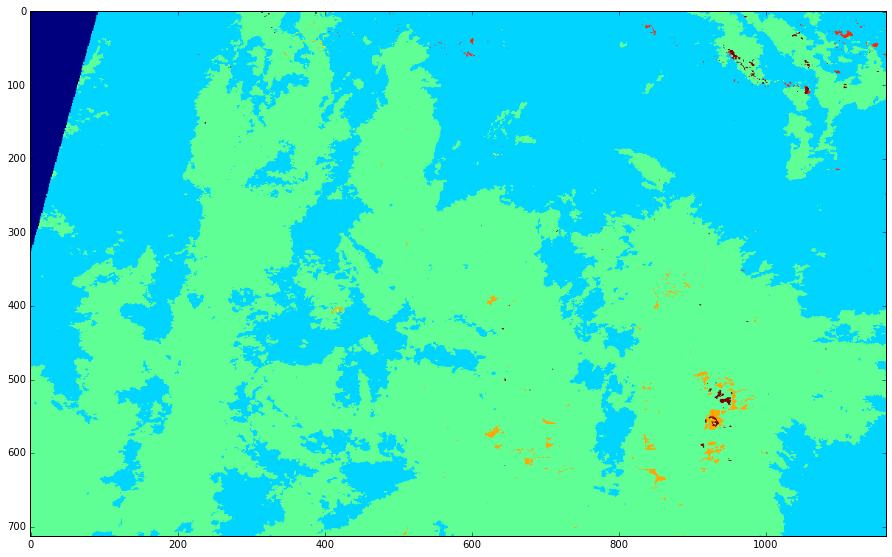

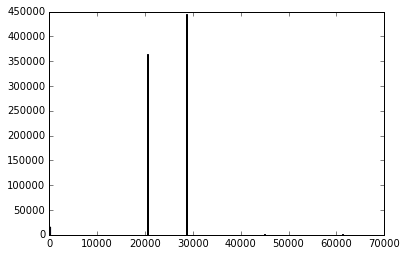

-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
-------------------------------------
Storing band array in GeoPandas DataFrame...

Returning dataframe... 
----------------------------

In [290]:
# Explore multi-band landsat data
input_file = os.path.join('../../../capstone_data/landsat_images/LANDSAT_LC8_L1T_8DAY_RAW_20130618.tif')
ExploreMultiBandImage(input_file)

# Test StoreBandinGPD()
#for x in range(1,13):
#    ('band_%s' % str(x)) = StoreBandinGPD(input_file, band_number=x)

band_1 = StoreBandinGPD(input_file, band_number=1)
band_2 = StoreBandinGPD(input_file, band_number=2)
band_3 = StoreBandinGPD(input_file, band_number=3)
band_4 = StoreBandinGPD(input_file, band_number=4)
band_5 = StoreBandinGPD(input_file, band_number=5)
band_6 = StoreBandinGPD(input_file, band_number=6)
band_7 = StoreBandinGPD(input_file, band_number=7)
band_8 = StoreBandinGPD(input_file, band_number=8)
band_9 = StoreBandinGPD(input_file, band_number=9)
band_10 = StoreBandinGPD(input_file, band_number=10)
band_11 = StoreBandinGPD(input_file, band_number=11)
band_12 = StoreBandinGPD(input_file, band_number=12)

In [225]:
mask_array.shape

(713, 1163)

In [226]:
band_3.shape

(713, 1163)

In [228]:
band_3.head()

,0,1,2,3,4,5,6,7,8,9,...,1153,1154,1155,1156,1157,1158,1159,1160,1161,1162
0,14968,14948,14987,14932,14932,14881,14968,14978,15004,15004,...,12055,12486,12486,12128,11624,11873,11385,11385,10748,10414
1,14939,14913,15047,15028,15028,14945,14945,15045,15155,15155,...,12417,12524,12524,12379,11944,11495,11213,11213,10516,9812
2,15000,14937,15017,15093,15093,15148,15087,15118,15159,15159,...,12741,12704,12704,12303,12001,11592,11013,11013,10396,10076
3,14961,15008,14999,15032,15032,15108,15117,15115,15251,15251,...,12322,12537,12537,12462,12258,11214,11222,11222,10482,10516
4,14935,15004,14941,14901,14901,14959,15126,15189,15383,15383,...,11787,12108,12108,12246,11997,11430,11440,11440,10694,10570


In [404]:
from sklearn.cluster import KMeans
from sklearn import metrics
from sklearn.utils import shuffle

In [358]:
list_of_bands = [band_1,band_2,band_3,band_4,band_5,band_6,band_7,band_8,band_9,band_10,band_11,band_12]

In [365]:
k = 10
kmeans = KMeans(n_clusters=k)

In [368]:
count=1
for band in list_of_bands:
    kmeans.fit(band)
    print 'silhouette_score for band_%s: ' %str(count), metrics.silhouette_score(band, labels, metric='euclidean')
    count = count+1

silhouette_score for band_1:  0.196939491083
silhouette_score for band_2:  0.185136470895
silhouette_score for band_3:  0.16176898363
silhouette_score for band_4:  0.17126137353
silhouette_score for band_5:  0.227515024637
silhouette_score for band_6:  0.117972413316
silhouette_score for band_7:  0.154419785219
silhouette_score for band_8:  0.159060217808
silhouette_score for band_9:  0.24775597832
silhouette_score for band_10:  0.235960462437
silhouette_score for band_11:  0.241664954297
silhouette_score for band_12:  0.147976530004


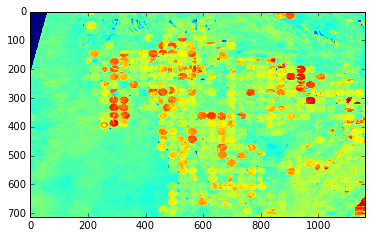

In [389]:
plt.imshow(band_5)

In [397]:
plt.imshow?

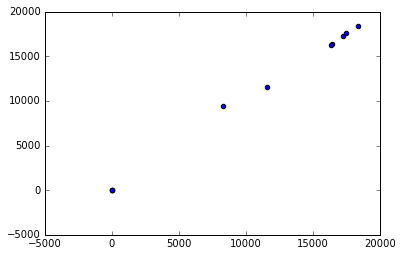

In [420]:
kmeans.fit(band_5)

prediction = kmeans.predict(band_5)
labels = kmeans.labels_
centroids = kmeans.cluster_centers_

plt.scatter(centroids[:, 0], centroids[:, 1])

In [424]:
for x in centroids:
    print x.mean()

21726.1477248
20066.3552307
22105.5810362
20044.02544
17941.7640869
21771.4739602
20454.9173593
21813.1595603
20675.5174119
19758.1831073


In [422]:
w=713
h=1163
image_array = band_5

#n_colors = k
codebook_random = shuffle(image_array, random_state=0) #[:n_colors + 1]
labels_random = metrics.pairwise_distances_argmin(codebook_random, image_array, axis=0)

def recreate_image(codebook, labels, w, h):
    """Recreate the (compressed) image from the code book & labels"""
    d = codebook.shape[1]
    image = np.zeros((w, h, d))
    label_idx = 0
    for i in range(w):
        for j in range(h):
            image[i][j] = codebook[labels[label_idx]]
            label_idx += 1
    return image

plt.imshow(recreate_image(codebook_random, labels_random, w, h))

ValueError: could not broadcast input array from shape (713) into shape (1163)

In [407]:
#plt.imshow(prediction)
labels_random

array([ 7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  9,  1,  1,  1,  1,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  2,  2,  2,
        2,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 10, 10, 10, 10, 10,
       10, 10, 10, 10, 10, 10, 10,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3

In [392]:
from sklearn.cluster import AgglomerativeClustering

In [395]:
AgglomerativeClustering?

In [394]:
aggcluster = AgglomerativeClustering(n_clusters=5)
aggcluster.fit(band_5)